# CMP 717 Course -- Homework 1
### by Muhammet Ali Ozturk (N22145407)

## Part 1) Add Gaussian Noise to the Images

#### 1.a) Apply Gaussian Noise

In [4]:
from typing import Tuple, List, Any

# import necessary packages
import numpy as np
import cv2
import matplotlib.pyplot as plt
import random

from numpy import ndarray

In [5]:
def add_gaussian_noise(img_path:str, variance:float, mean:float) -> []:
    original_image = cv2.imread(f"{img_path}")
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    Gauss_Noise = np.zeros_like(original_image)

    var = variance
    sigma = var ** 0.5
    mean = mean

    cv2.randn(Gauss_Noise, mean, sigma)

    gauss_noise = (Gauss_Noise*0.5).astype(np.uint8)
    gaussian_noised_img = cv2.add(original_image, gauss_noise)

    fig = plt.figure(dpi=128)

    fig.add_subplot(1,2,1)
    plt.imshow(original_image)
    plt.title(f"Original Image (GrayScaled)", fontsize=10)

    fig.add_subplot(1,2,2)
    plt.imshow(gaussian_noised_img)
    plt.title(f"Gaussian Noised Img\n(variance: {variance}, mean: {mean})", fontsize=10)

    fig.tight_layout(pad=1.0)
    plt.show()

    return original_image, gaussian_noised_img

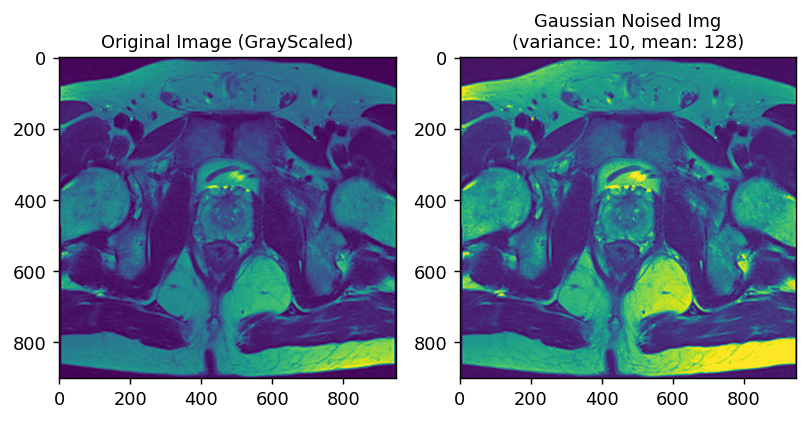

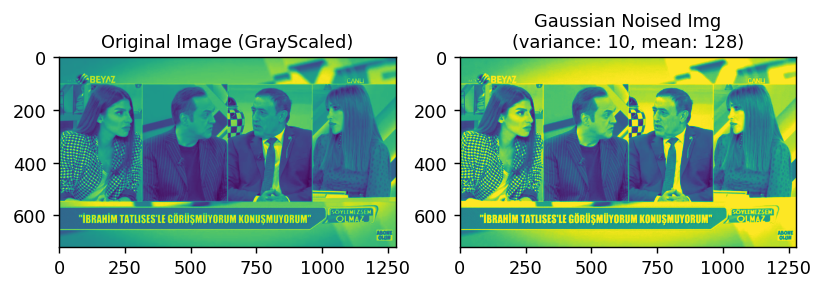

In [6]:
m_high_original_image, m_high_gn_image = add_gaussian_noise("m_high.jpg", 10, 128)
mt_high_original_image, mt_high_gn_image = add_gaussian_noise("mt_high.jpg", 10, 128)

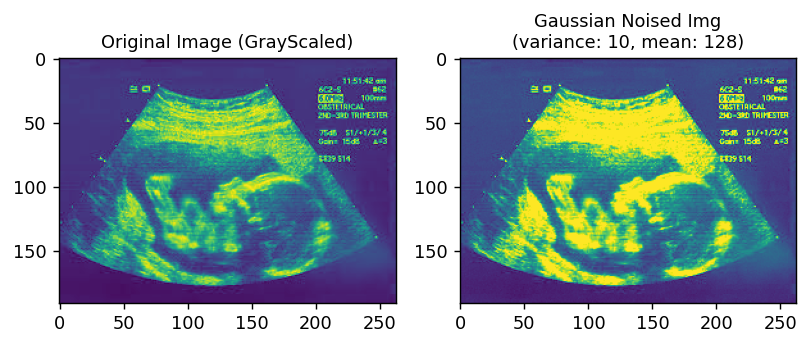

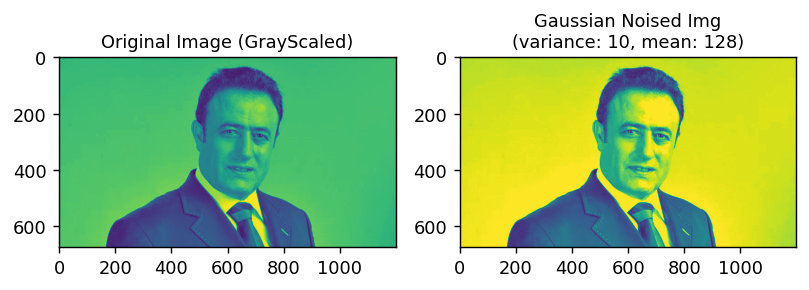

In [7]:
m_low_original_image, m_low_gn_image = add_gaussian_noise("m_low.jpg", 10, 128)
mt_low_original_image, mt_low_gn_image = add_gaussian_noise("mt_low.jpg", 10, 128)


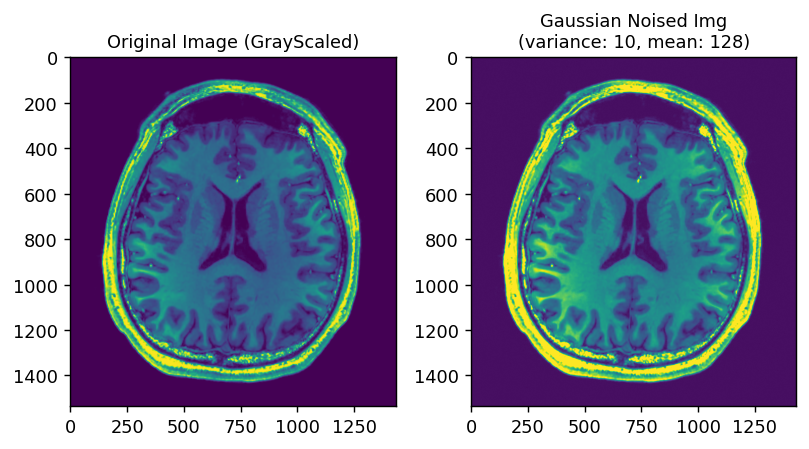

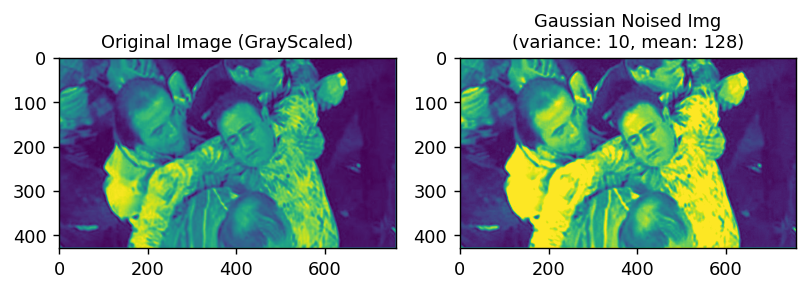

In [8]:

m_mid_original_image, m_mid_gn_image = add_gaussian_noise("m_mid.jpg", 10, 128)
mt_mid_original_image, mt_mid_gn_image = add_gaussian_noise("mt_mid.jpg", 10, 128)

#### 1.b) Apply edge preserving filters with 0.1, 0.5 and 0.8 probabilities to noised images

##### Bilateral Filter

In [9]:
def apply_bileteral_filter(label:str, noisy_img:np.ndarray, filter_size:int, sigma_color:int, sigma_space:int, probabilities:list) -> tuple:
    """
    sigmaColor: Standard deviation of the color space. A larger value of sigmaColor means that farther colors within the pixel neighborhood will be mixed together,
    resulting in larger areas of semi-equal color. A smaller value of sigmaColor means that closer colors within the pixel neighborhood will be mixed together,
    resulting in smaller areas of semi-equal color. sigmaColor generally ranges between 10-200.

    sigmaSpace: Standard deviation of the coordinate space in pixels. A larger value of sigmaSpace means that farther pixels will influence each other during
     the filtering process, resulting in more smoothing. A smaller value of sigmaSpace means that only closer pixels will influence each other,
      resulting in less smoothing. sigmaSpace generally ranges between 10-200.
    """
    filter_applied_imgs = []
    for probability in probabilities:
        mask = np.random.choice([0,1], size=noisy_img.shape, p=[probability, 1-probability])
        img_masked = noisy_img + (255 - noisy_img) * mask
        img=cv2.bilateralFilter(img_masked.astype(np.uint8), filter_size, sigma_color, sigma_space)
        filter_applied_imgs.append(img)

    fig = plt.figure(dpi=256)
    ax = fig.add_subplot(1, len(filter_applied_imgs)+1, 1)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.imshow(noisy_img)
    plt.title(f"{label} Input Image", fontsize=5)



    for i in range(1, len(filter_applied_imgs) + 1):
        ax = fig.add_subplot(1,len(filter_applied_imgs)+1, i+1)
        ax.set_xticks([])
        ax.set_yticks([])
        plt.imshow(filter_applied_imgs[i-1])
        plt.title(f"Probability: {probabilities[i-1]}", fontsize=5)

    fig.tight_layout(pad=2.0)
    plt.show()
    return noisy_img, filter_applied_imgs


##### Medical Images

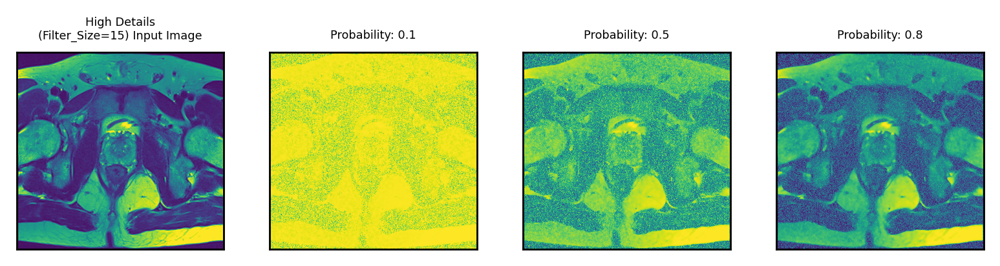

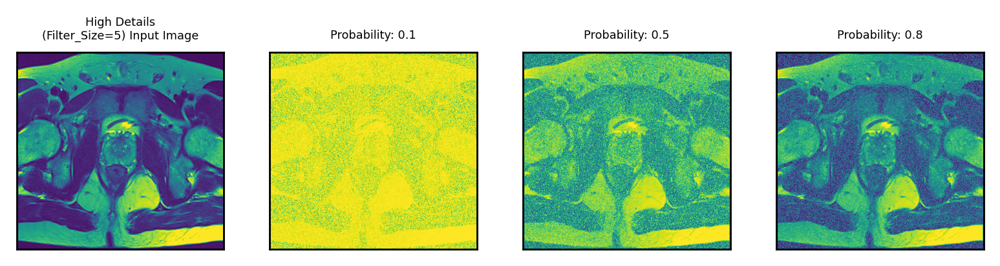

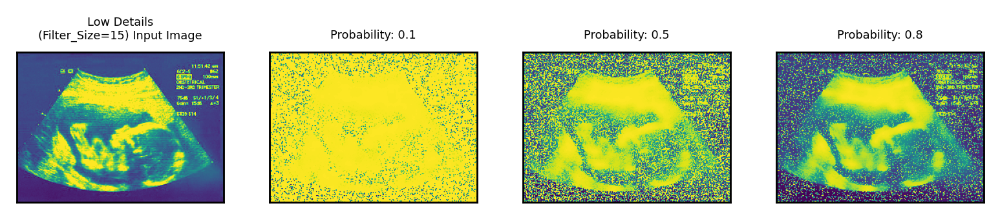

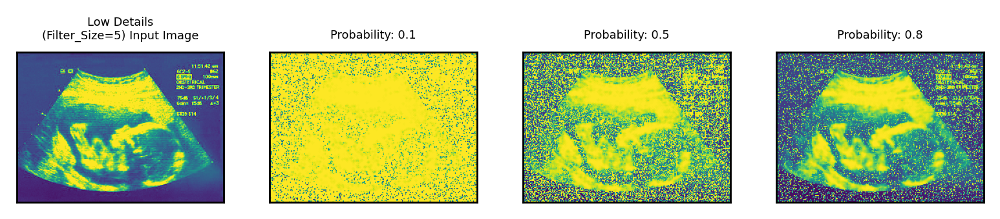

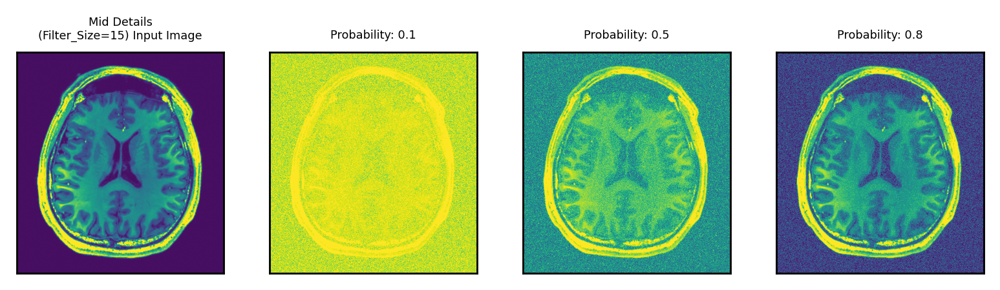

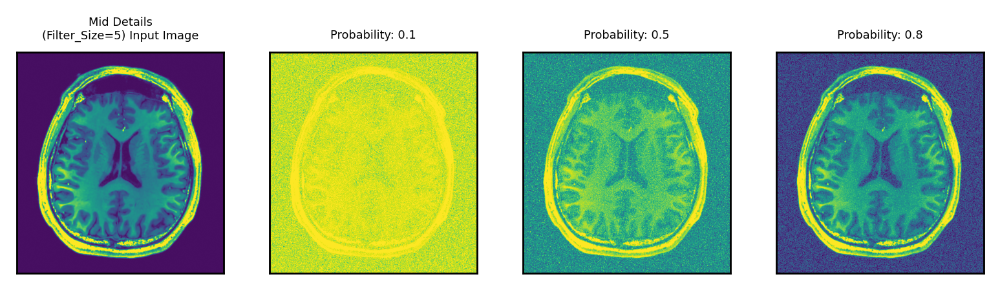

In [10]:
original_noisy_img, filter_applied_images = apply_bileteral_filter("High Details\n(Filter_Size=15)", m_high_gn_image, 15, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("High Details\n(Filter_Size=5)", m_high_gn_image, 5, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("Low Details\n(Filter_Size=15)", m_low_gn_image, 15, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("Low Details\n(Filter_Size=5)", m_low_gn_image, 5, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("Mid Details\n(Filter_Size=15)", m_mid_gn_image, 15, 10, 200, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("Mid Details\n(Filter_Size=5)", m_mid_gn_image, 5, 10, 200, [0.1, 0.5, 0.8])

##### Mahmut Tuncer images

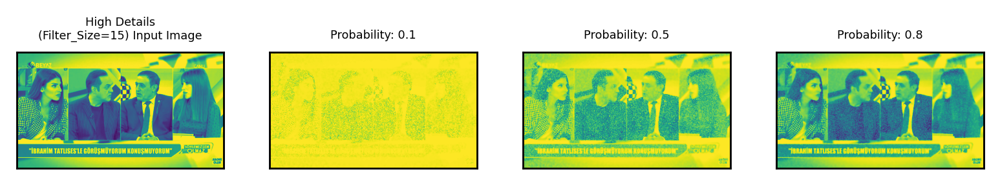

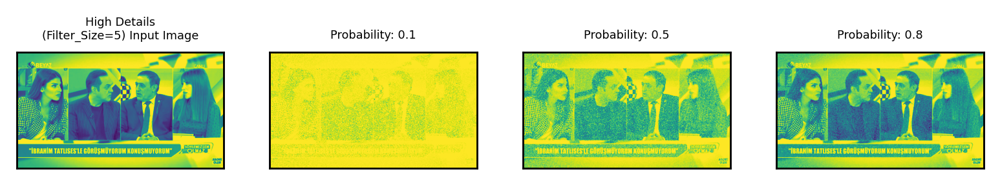

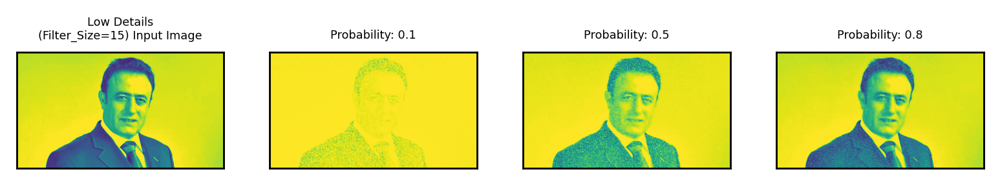

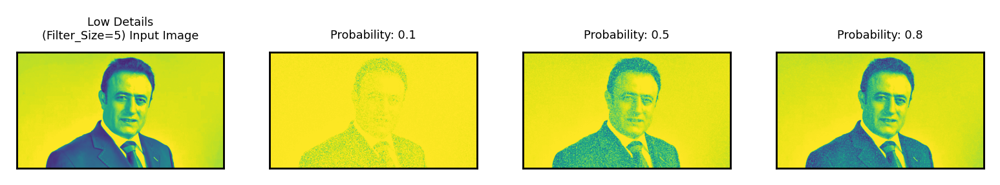

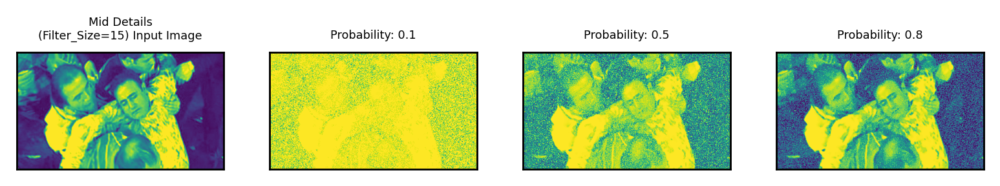

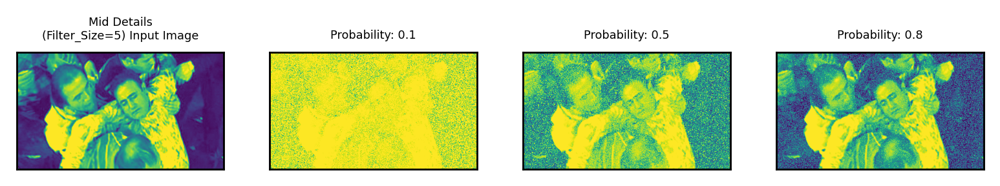

In [11]:
original_noisy_img, filter_applied_images_mt_hd15 = apply_bileteral_filter("High Details\n(Filter_Size=15)", mt_high_gn_image, 15, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images_mt_hd5 = apply_bileteral_filter("High Details\n(Filter_Size=5)", mt_high_gn_image, 5, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images_mt_ld15 = apply_bileteral_filter("Low Details\n(Filter_Size=15)", mt_low_gn_image, 15, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images_mt_ld5 = apply_bileteral_filter("Low Details\n(Filter_Size=5)", mt_low_gn_image, 5, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images_mt_medd15 = apply_bileteral_filter("Mid Details\n(Filter_Size=15)", mt_mid_gn_image, 15, 10, 200, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images_mt_medd5 = apply_bileteral_filter("Mid Details\n(Filter_Size=5)", mt_mid_gn_image, 5, 10, 200, [0.1, 0.5, 0.8])

##### Median-Filter

In [12]:
def apply_medfilt_grayscale(label:str, noisy_img:np.ndarray, filter_size:int, probabilities:list) -> tuple:
    """
    This filter is a non-linear filter that replaces each pixel with the median of its neighboring pixels.
    The median filter is an effective way to remove noise from an image while preserving edges.
    The median filter can be applied with a probability by randomly choosing which pixels to filter and which to leave unchanged.
    """
    filter_applied_imgs = []
    for probability in probabilities:
        mask = np.random.choice([0,1], size=noisy_img.shape, p=[probability, 1-probability])
        img_masked = noisy_img + (255 - noisy_img) * mask
        img = cv2.medianBlur(img_masked.astype(np.uint8), ksize=filter_size)
        filter_applied_imgs.append(img)

    fig = plt.figure(dpi=256)
    ax = fig.add_subplot(1, len(filter_applied_imgs)+1, 1)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.imshow(noisy_img)
    plt.title(f"{label} Input Image", fontsize=5)



    for i in range(1, len(filter_applied_imgs) + 1):
        ax = fig.add_subplot(1,len(filter_applied_imgs)+1, i+1)
        ax.set_xticks([])
        ax.set_yticks([])
        plt.imshow(filter_applied_imgs[i-1])
        plt.title(f"Probability: {probabilities[i-1]}", fontsize=5)

    fig.tight_layout(pad=2.0)
    plt.show()
    return noisy_img, filter_applied_imgs



##### Medical Images

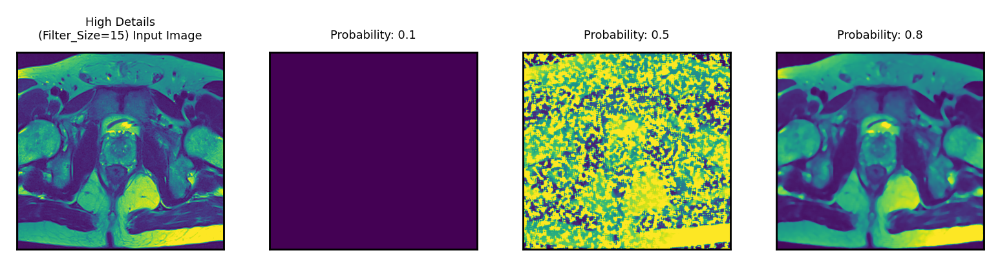

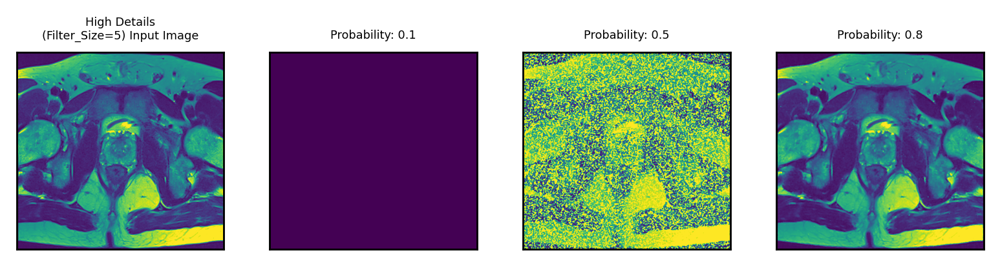

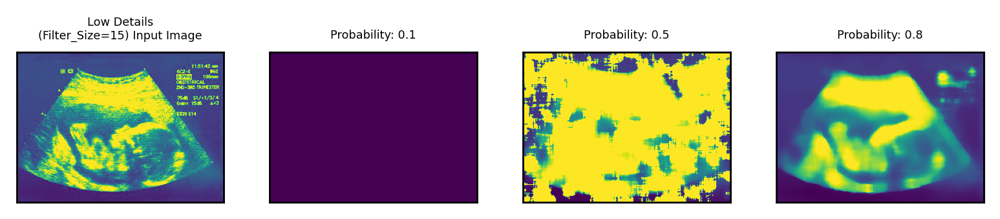

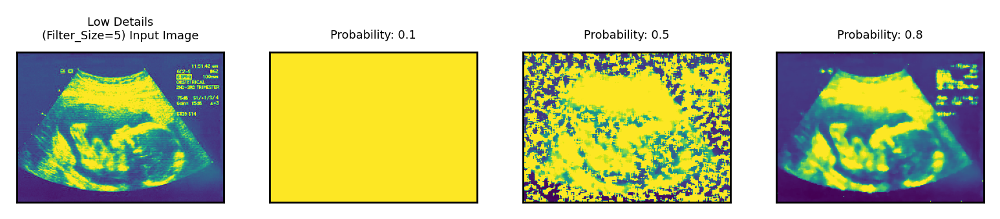

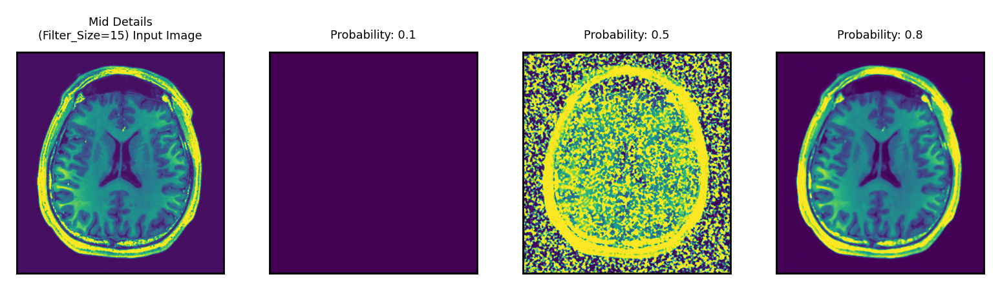

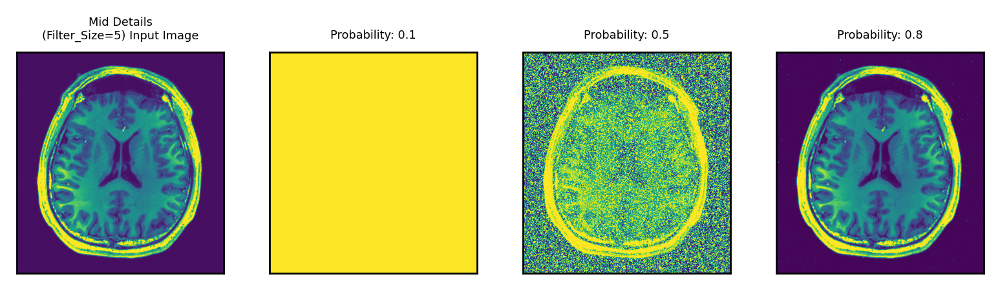

In [13]:
_, _ = apply_medfilt_grayscale("High Details\n(Filter_Size=15)", m_high_gn_image, 15,[0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("High Details\n(Filter_Size=5)", m_high_gn_image, 5, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Low Details\n(Filter_Size=15)", m_low_gn_image, 15, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Low Details\n(Filter_Size=5)", m_low_gn_image, 5, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Mid Details\n(Filter_Size=15)", m_mid_gn_image, 15, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Mid Details\n(Filter_Size=5)", m_mid_gn_image, 5, [0.1, 0.5, 0.8])

##### MT images

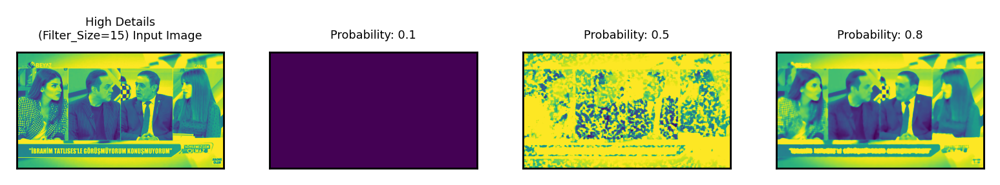

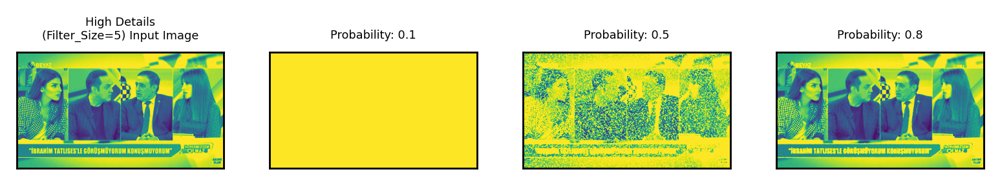

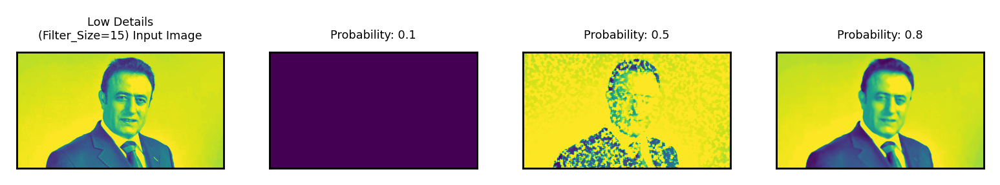

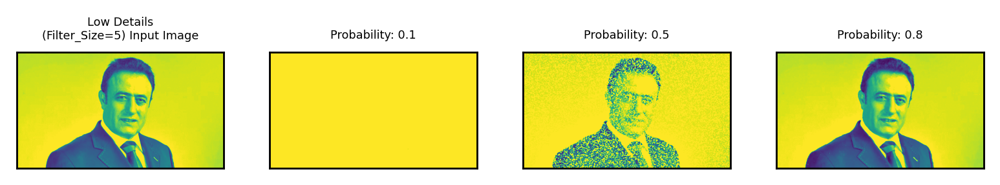

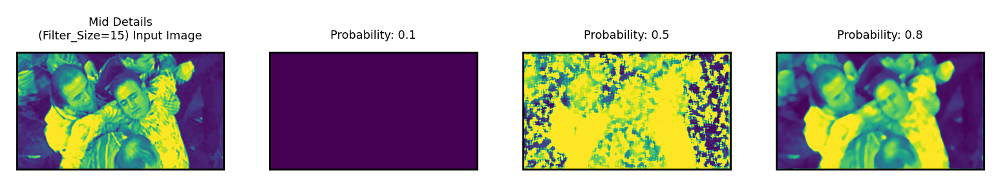

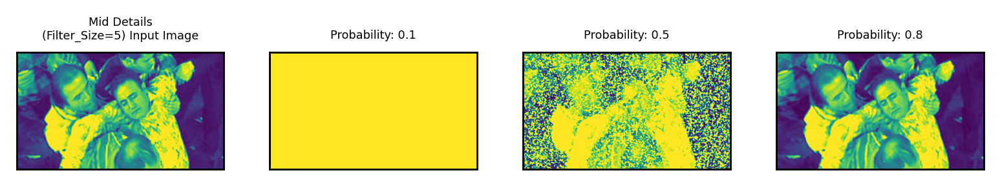

In [14]:
_, _ = apply_medfilt_grayscale("High Details\n(Filter_Size=15)", mt_high_gn_image, 15,[0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("High Details\n(Filter_Size=5)", mt_high_gn_image, 5, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Low Details\n(Filter_Size=15)", mt_low_gn_image, 15, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Low Details\n(Filter_Size=5)", mt_low_gn_image, 5, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Mid Details\n(Filter_Size=15)", mt_mid_gn_image, 15, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Mid Details\n(Filter_Size=5)", mt_mid_gn_image, 5, [0.1, 0.5, 0.8])

# 1.b) Applying median and bilateral filters similarly to Uniform Noised Images

In [15]:
def add_uniform_noise(img_path:str) -> []:
    original_image = cv2.imread(f"{img_path}")
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    Uniform_Noise = np.zeros_like(original_image)

    cv2.randu(Uniform_Noise, 0, 255)

    uni_noise = (Uniform_Noise*0.5).astype(np.uint8)
    uni_noised_img = cv2.add(original_image, uni_noise)

    fig = plt.figure(dpi=128)

    fig.add_subplot(1,2,1)
    plt.imshow(original_image)
    plt.title(f"Original Image (GrayScaled)", fontsize=10)

    fig.add_subplot(1,2,2)
    plt.imshow(uni_noised_img)
    plt.title(f"Uniform Noised Img", fontsize=10)

    fig.tight_layout(pad=1.0)
    plt.show()

    return original_image, uni_noised_img

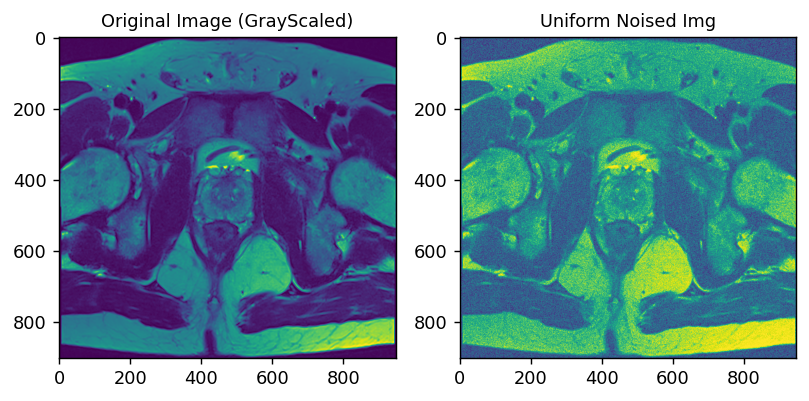

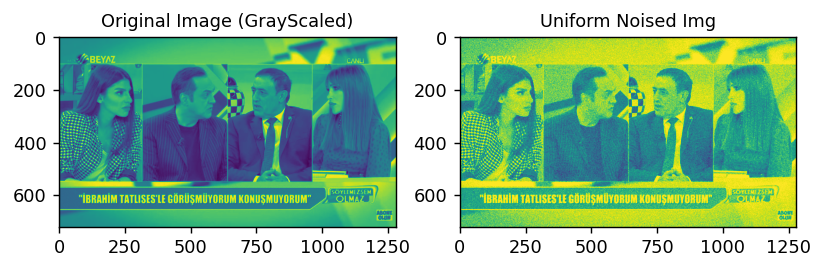

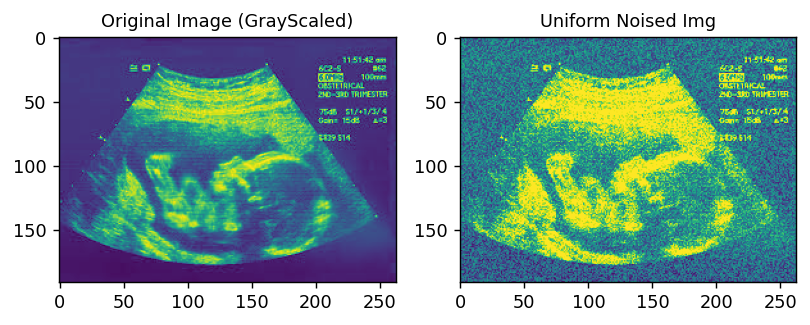

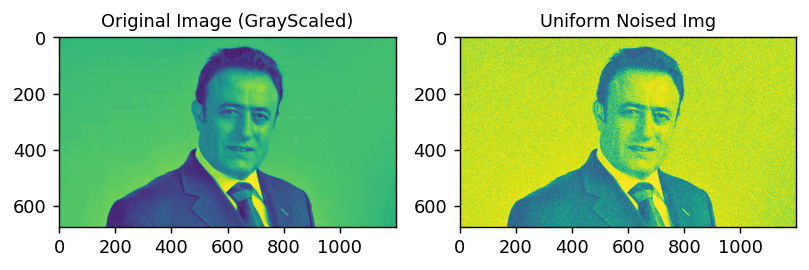

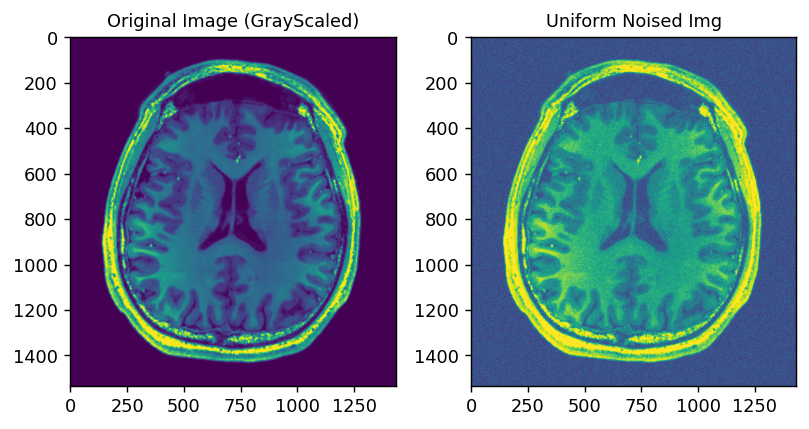

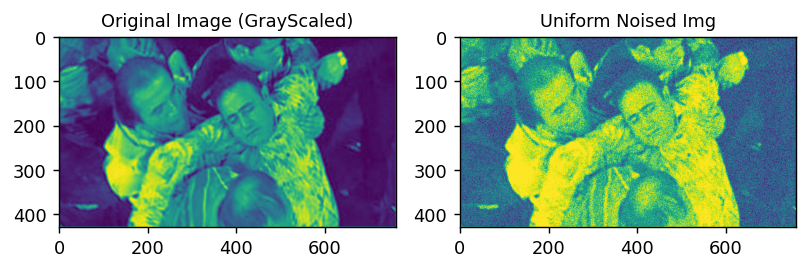

In [16]:
m_high_original_image, m_high_un_image = add_uniform_noise("m_high.jpg")
mt_high_original_image, mt_high_un_image = add_uniform_noise("mt_high.jpg")
m_low_original_image, m_low_un_image = add_uniform_noise("m_low.jpg")
mt_low_original_image, mt_low_un_image = add_uniform_noise("mt_low.jpg")
m_mid_original_image, m_mid_un_image = add_uniform_noise("m_mid.jpg")
mt_mid_original_image, mt_mid_un_image = add_uniform_noise("mt_mid.jpg")

### Apply filters similarly to medical and MT images respectively.

##### Apply BiLateral Filter to Uniform Noised Medical Images

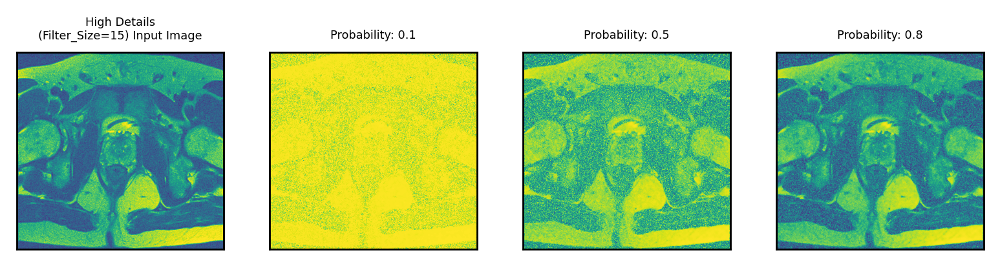

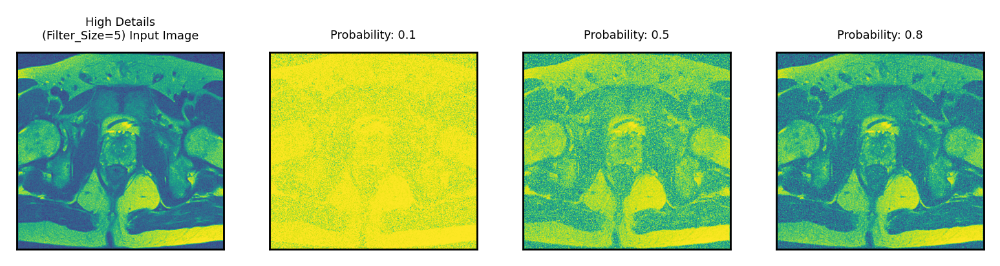

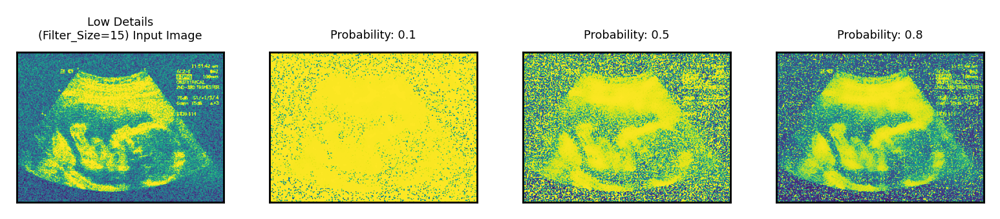

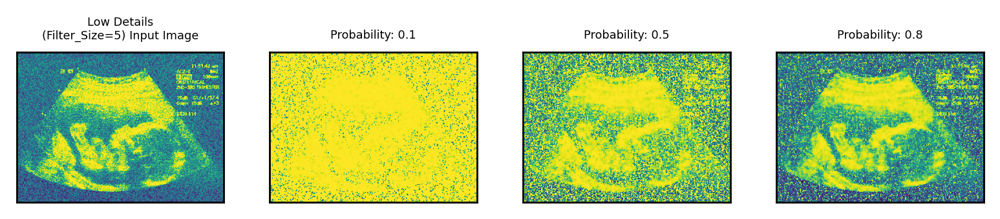

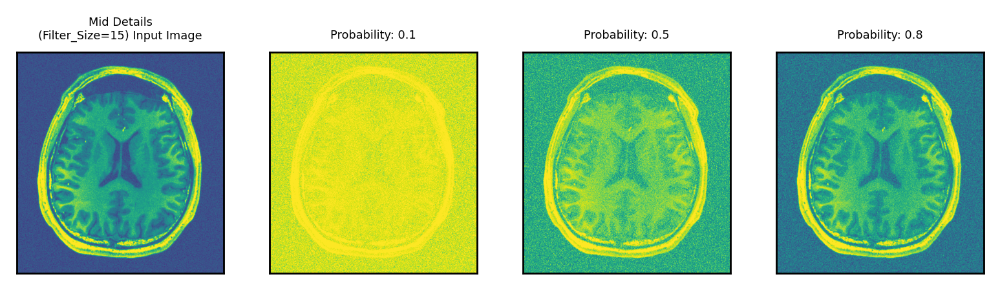

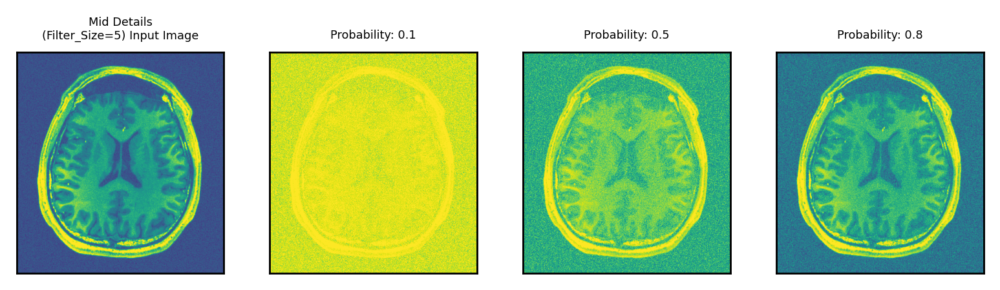

In [17]:
original_noisy_img, filter_applied_images = apply_bileteral_filter("High Details\n(Filter_Size=15)", m_high_un_image, 15, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("High Details\n(Filter_Size=5)", m_high_un_image, 5, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("Low Details\n(Filter_Size=15)", m_low_un_image, 15, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("Low Details\n(Filter_Size=5)", m_low_un_image, 5, 50, 50, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("Mid Details\n(Filter_Size=15)", m_mid_un_image, 15, 10, 200, [0.1, 0.5, 0.8])
original_noisy_img, filter_applied_images = apply_bileteral_filter("Mid Details\n(Filter_Size=5)", m_mid_un_image, 5, 10, 200, [0.1, 0.5, 0.8])

##### Apply BiLateral Filter to Uniform Noised Mahmut Tuncer Images

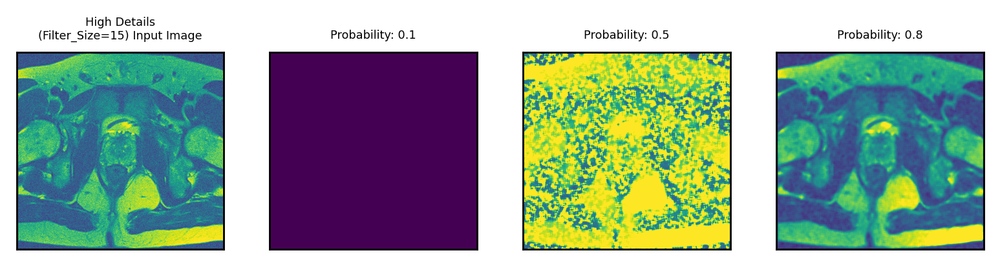

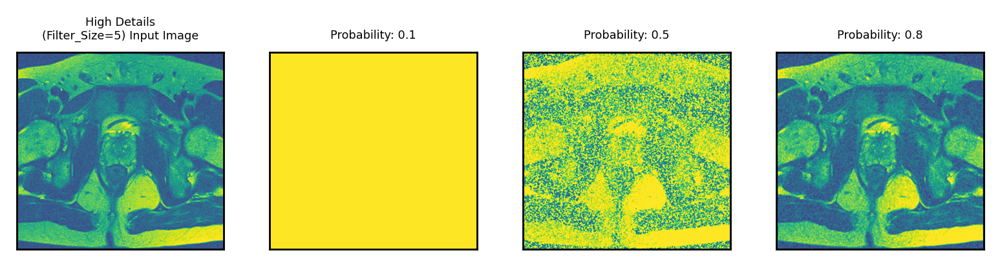

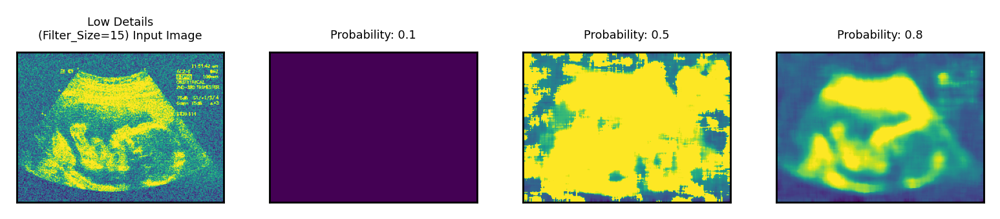

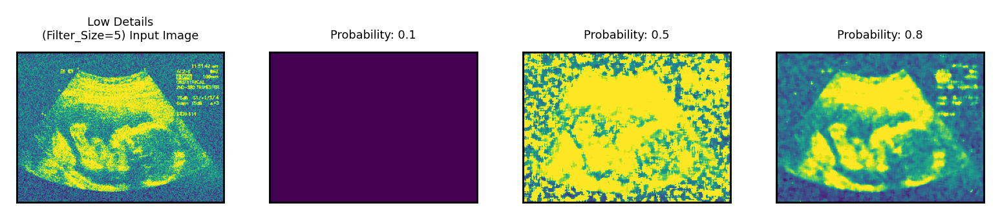

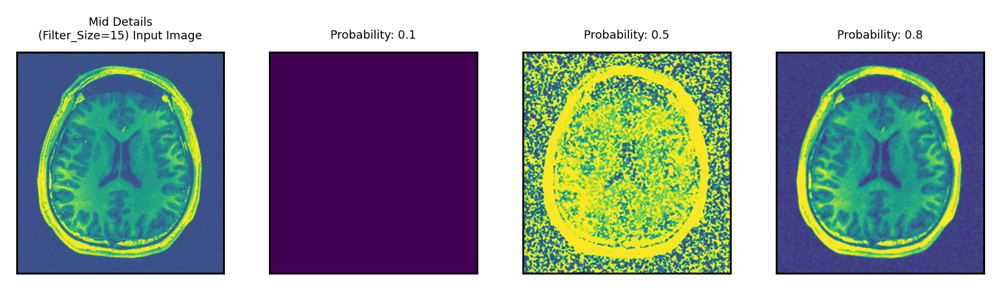

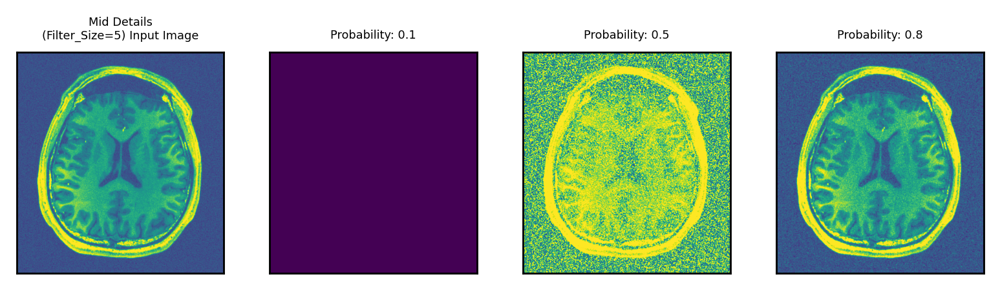

In [18]:
_, _ = apply_medfilt_grayscale("High Details\n(Filter_Size=15)", m_high_un_image, 15,[0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("High Details\n(Filter_Size=5)", m_high_un_image, 5, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Low Details\n(Filter_Size=15)", m_low_un_image, 15, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Low Details\n(Filter_Size=5)", m_low_un_image, 5, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Mid Details\n(Filter_Size=15)", m_mid_un_image, 15, [0.1, 0.5, 0.8])
_, _ = apply_medfilt_grayscale("Mid Details\n(Filter_Size=5)", m_mid_un_image, 5, [0.1, 0.5, 0.8])

# Conclusion (Report)

<p> We clearly saw that in lower probability cases, median filter is losing too much information compared to the bilateral filter, as can be seen from the above examples mentioned in results section. On the other hand, median filter did perform nicely on high detailed images on high probability cases, visually was looking better compared to the bilateral filter we applied to the same noisy images.

Besides filters, if we come to the noise types, adding Gaussian noise to the images clearly have given better clarity to the edges in the original images both on low and high details images compared to the uniform noise. </p>